# Applying SHRED to the Zebrafish Dataset 

Data obtained from Global Brain Dynamics Embed the Motor Command Sequence of Caenorhabditis elegans. Cell, 163(3), 656–669. http://doi.org/10.1016/j.cell.2015.09.034

SHRED (SHallow REcurrent Decoder) models are a network architecture that merges a recurrent layer (LSTM) with a shallow decoder network (SDN) to reconstruct high-dimensional spatio-temporal fields from a trajectory of sensor measurements of the field. More formally, the SHRED architecture can be written as
$$ \mathcal {H} \left( \{ y_i \} _{i=t-k}^t \right) = \mathcal {F} \left( \mathcal {G} \left( \{ y_i \} _{i=t-k}^t \right) ; W_{RN}) ; W_{SD} \right)$$
where $\mathcal F$ is a feed forward network parameterized by weights $W_{SD}$, $\mathcal G$ is a LSTM network parameterized by weights $W_{RN}$, and $\{ y_i \} _{i=t-k}^t$ is a trajectory of sensor measurements of a high-dimensional spatio-temporal field $\{ x_i \} _{i=t-k}^t$.

**Experiment C: Reconstruct forebrain activity of zebra fish from 250 pixels.**

Note: data output files are too large to include in the repository. Please re-run the code to reproduce the results seen in the paper.


In [1]:
# Importing all dependencies 
import numpy as np
import numpy as np
import torch
import subprocess
import os
import torch
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
import random
import mne
from scipy.signal import butter, filtfilt
from scipy.signal import welch
from scipy.interpolate import CubicSpline
from scipy.io import loadmat
from sklearn.linear_model import Ridge
import cv2
import matplotlib.animation as animation
from IPython.display import HTML



In [2]:
#Importing packages
# Change into the directory
os.chdir("/home/amy/SHRED_neuro/sindy-shred") ## Change to where the repo was cloned

from processdata import load_data
from processdata import TimeSeriesDataset
import sindy
import pysindy as ps
from pysindy.differentiation import FiniteDifference

os.environ["CUDA_VISIBLE_DEVICES"]="0"


In [3]:
# Load the video
video_path = '/home/amy/SHRED_neuro/zebra_fish/data/forebrain.avi'
cap = cv2.VideoCapture(video_path)

frames = []

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break
    # Convert to grayscale if needed
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    
    frames.append(frame)

cap.release()

# Convert list of frames to a numpy array
video_matrix = np.array(frames)  # Shape: (num_frames, height, width, channels)

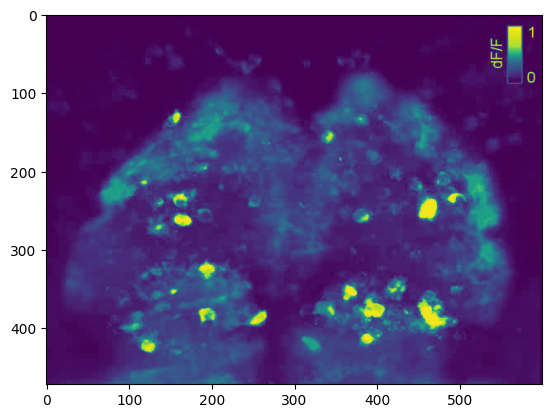

In [4]:
plt.imshow(video_matrix[0,:,:600], aspect = 'auto')

Animation size has reached 21054193 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


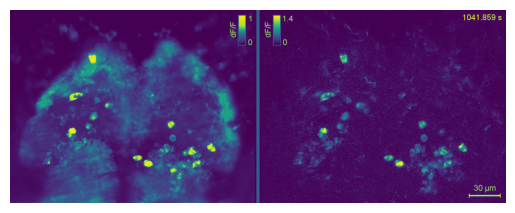

In [5]:
fig, ax = plt.subplots()
im = ax.imshow(frames[0])
ax.axis('off')

# Animation update function
def update(i):
    im.set_data(frames[i])
    return [im]

# Create animation
ani = animation.FuncAnimation(fig, update, frames=len(frames), interval=30, blit=True)
HTML(ani.to_jshtml())



In [6]:
forebrain_mat = video_matrix[:,:,:600]
print(forebrain_mat.shape) # shape: 750 timepoints, 472x600 images
n_t = forebrain_mat.shape[0]
n_row = forebrain_mat.shape[1]
n_col = forebrain_mat.shape[2]
load_X = forebrain_mat.reshape(forebrain_mat.shape[0], -1)
n_sens = load_X.shape[1]
print(load_X.shape)
dt = 1041.859/n_t


(750, 472, 600)
(750, 283200)


In [8]:
# Splitting into high and low variance pixels
var = np.std(load_X, axis = 0)
var_ave = np.mean(var)

high_ind = np.where(var > var_ave)[0]
low_ind = np.where(var < var_ave)[0]

**Example: select 3 randomly from high variance**

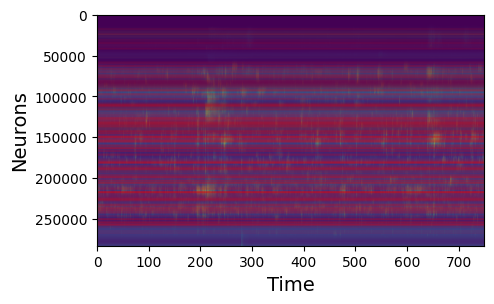

In [9]:
num_pixels = 300

# Randomly select the neurons to train the SHRED model on
indices = np.random.choice(high_ind.shape[0], size= num_pixels, replace=False) 
neuron_locations = high_ind[indices]

#Plotting the Carpet plot
plt.figure(figsize = (5,3))
plt.imshow(load_X.T, aspect = 'auto')

plt.xlabel('Time', fontsize = 14)
plt.ylabel('Neurons',fontsize = 14)

for i in range(neuron_locations.shape[0]):
  plt.axhline(neuron_locations[i], color = 'red', linewidth = 0.1)

In [107]:
lags = 50
test_val_size = 50

train_indices = np.arange(0, n_t - lags - test_val_size)
mask = np.ones(n_t - lags)
mask[train_indices] = 0
valid_test_indices = np.arange(0, n_t - lags)[np.where(mask!=0)[0]]
valid_indices = valid_test_indices[:int(test_val_size/2)]
test_indices = valid_test_indices[int(test_val_size/2):test_val_size]

In [108]:
sc = MinMaxScaler()
sc = sc.fit(load_X[train_indices])
transformed_X = sc.transform(load_X)

### Generate input sequences to a SHRED model
all_data_in = np.zeros((n_t - lags, lags, num_pixels))
for i in range(len(all_data_in)):
    all_data_in[i] = transformed_X[i:i+lags, neuron_locations]

### Generate training validation and test datasets both for reconstruction of states and forecasting sensors
device = 'cuda' if torch.cuda.is_available() else 'cpu'

train_data_in = torch.tensor(all_data_in[train_indices], dtype=torch.float32).to(device)
valid_data_in = torch.tensor(all_data_in[valid_indices], dtype=torch.float32).to(device)
test_data_in = torch.tensor(all_data_in[test_indices], dtype=torch.float32).to(device)

### -1 to have output be at the same time as final sensor measurements
train_data_out = torch.tensor(transformed_X[train_indices + lags - 1], dtype=torch.float32).to(device)
valid_data_out = torch.tensor(transformed_X[valid_indices + lags - 1], dtype=torch.float32).to(device)
test_data_out = torch.tensor(transformed_X[test_indices + lags - 1], dtype=torch.float32).to(device)

train_dataset = TimeSeriesDataset(train_data_in, train_data_out)
valid_dataset = TimeSeriesDataset(valid_data_in, valid_data_out)
test_dataset = TimeSeriesDataset(test_data_in, test_data_out)

In [109]:
latent_dim = 128
poly_order = 1
include_sine = False
library_dim = sindy.library_size(latent_dim, poly_order, include_sine, True)
os.chdir("/home/amy/SHRED_neuro/sindy-shred")
import sindy_shred

In [110]:
k=3


shred = sindy_shred.SINDy_SHRED(num_pixels, n_sens, hidden_size=latent_dim, hidden_layers=2, l1=350, l2=400, dropout=0.1,
                                    library_dim=library_dim, poly_order=poly_order,
                                    include_sine=include_sine, dt=dt, layer_norm=False).to(device)

validation_errors = sindy_shred.fit(shred, train_dataset, valid_dataset, batch_size=128, num_epochs=200,
                                    lr=1e-3, verbose=True, threshold=0.25, patience=5, sindy_regularization=10.0,
                                    optimizer="AdamW", thres_epoch=100)

test_recons = sc.inverse_transform(shred(test_dataset.X).detach().cpu().numpy())
test_ground_truth = sc.inverse_transform(test_dataset.Y.detach().cpu().numpy())
mse_test = np.linalg.norm(test_recons - test_ground_truth) / np.linalg.norm(test_ground_truth)
print('mse test', mse_test)
train_recons = sc.inverse_transform(shred(train_dataset.X).detach().cpu().numpy())
train_ground_truth = sc.inverse_transform(train_dataset.Y.detach().cpu().numpy())
mse_train = np.linalg.norm(train_recons - train_ground_truth) / np.linalg.norm(train_ground_truth)
print('mse train', mse_train)

file_path = f"/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/train_recon_{k+1}.npy"
np.save(file_path, train_recons)
file_path = f"/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/test_recon_{k+1}.npy"
np.save(file_path, test_recons)
file_path = f"/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/train_gt_{k+1}.npy"
np.save(file_path, train_ground_truth)
file_path = f"/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/test_gt_{k+1}.npy"
np.save(file_path, test_ground_truth)
file_path = f"/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/mse_{k+1}.npy"
np.save(file_path, [mse_train, mse_test])

1 : tensor(0.1691, device='cuda:0', grad_fn=<AddBackward0>)
2 : tensor(0.0947, device='cuda:0', grad_fn=<AddBackward0>)
3 : tensor(0.0687, device='cuda:0', grad_fn=<AddBackward0>)
4 : tensor(0.0475, device='cuda:0', grad_fn=<AddBackward0>)
5 : tensor(0.0424, device='cuda:0', grad_fn=<AddBackward0>)
6 : tensor(0.0408, device='cuda:0', grad_fn=<AddBackward0>)
7 : tensor(0.0353, device='cuda:0', grad_fn=<AddBackward0>)
8 : tensor(0.0336, device='cuda:0', grad_fn=<AddBackward0>)
9 : tensor(0.0330, device='cuda:0', grad_fn=<AddBackward0>)
10 : tensor(0.0292, device='cuda:0', grad_fn=<AddBackward0>)
11 : tensor(0.0361, device='cuda:0', grad_fn=<AddBackward0>)
12 : tensor(0.0313, device='cuda:0', grad_fn=<AddBackward0>)
13 : tensor(0.0277, device='cuda:0', grad_fn=<AddBackward0>)
14 : tensor(0.0263, device='cuda:0', grad_fn=<AddBackward0>)
15 : tensor(0.0249, device='cuda:0', grad_fn=<AddBackward0>)
16 : tensor(0.0229, device='cuda:0', grad_fn=<AddBackward0>)
17 : tensor(0.0237, device='cuda:

In [8]:
train_recons = np.load("/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/train_recon_3.npy")
test_recons = np.load("/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/test_recon_3.npy")
train_ground_truth = np.load("/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/train_gt_3.npy")
test_ground_truth = np.load("/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/test_gt_3.npy")


recon = np.vstack((train_recons, test_recons))
gt = np.vstack((train_ground_truth, test_ground_truth))

recon_reshape = recon.reshape(recon.shape[0], n_row, n_col)
gt_reshape = gt.reshape(gt.shape[0], n_row, n_col)

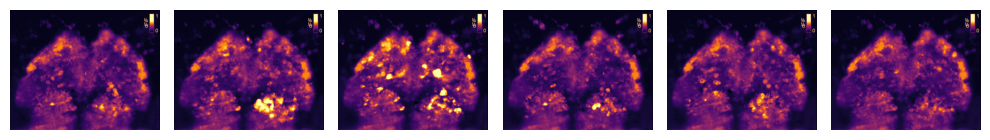

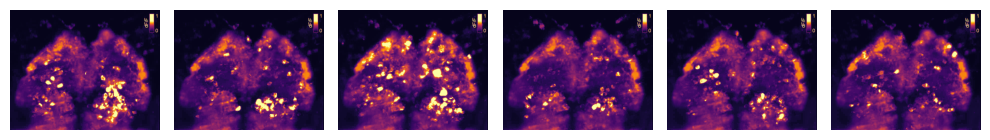

In [ ]:
ind = [50, 100, 150, 200, 250, 300]
fig, axes = plt.subplots(1, 6, figsize=(10, 1.5))
axes = axes.flatten()
for i in range(6):
    im = axes[i].imshow(recon_reshape[ind[i],:,:], aspect = 'auto', vmin = -10, vmax = 200, cmap = 'inferno')
    axes[i].axis('off')  # Hide axes
plt.tight_layout()
plt.savefig("/home/amy/SHRED_neuro/zebra_fish/data_output/figs/recons.png", transparent=True, dpi=500)
plt.show()

fig, axes = plt.subplots(1, 6, figsize=(10, 1.5))
axes = axes.flatten()
for i in range(6):
    im = axes[i].imshow(gt_reshape[ind[i],:,:], aspect = 'auto', vmin = -10, vmax = 200, cmap = 'inferno')
    axes[i].axis('off')  # Hide axes
plt.tight_layout()
plt.savefig("/home/amy/SHRED_neuro/zebra_fish/data_output/figs/gt.png", transparent=True, dpi=500)
plt.show()

Animation size has reached 21130904 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


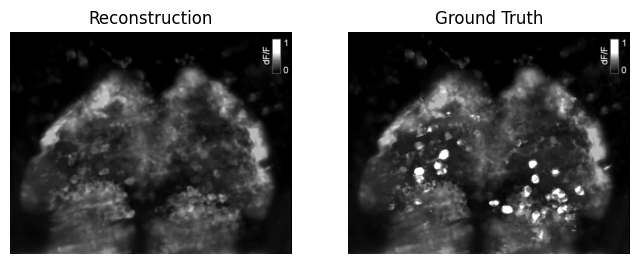

In [122]:
# Initialize each subplot with the first frame
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
ax1, ax2 = axes
im1 = ax1.imshow(recon_reshape[0], cmap='gray', vmin=0, vmax=200)
ax1.set_title('Reconstruction')
ax1.axis('off')

im2 = ax2.imshow(gt_reshape[0], cmap='gray', vmin=0, vmax=200)
ax2.set_title('Ground Truth')
ax2.axis('off')

# Update function: set the data for both images
def update(frame_idx):
    im1.set_data(recon_reshape[frame_idx])
    im2.set_data(gt_reshape[frame_idx])
    return im1, im2

# Build the animation
ani = animation.FuncAnimation(
    fig,
    update,
    frames=recon_reshape.shape[0],
    interval=30,   # milliseconds between frames (adjust to taste)
    blit=True
)

# Display in‐notebook
HTML(ani.to_jshtml())

ani.save('/home/amy/SHRED_neuro/zebra_fish/data_output/exp_1/forebrain.gif', writer='pillow', fps=30)
